# Vehicles Craigslist EDA


In [1]:
from pathlib import Path
import csv
from uuid import uuid4

from IPython.display import HTML, Markdown, display
import eda

DATA_PATH = Path("vehicles.csv")
if not DATA_PATH.exists():
    raise FileNotFoundError("Expected vehicles.csv next to this notebook")

print(f"Dataset located at: {DATA_PATH.resolve()}")


Dataset located at: /Users/colbywatts/Documents/College/Fall 2025/CSC 466/CSC-466/project/vehicles.csv


In [2]:
import pandas as pd

df = pd.read_csv(DATA_PATH)
df.head()

,id,url,region,region_url,price,year,manufacturer,model,condition,cylinders,...,size,type,paint_color,image_url,description,county,state,lat,long,posting_date
0,7222695916,https://prescott.craigslist.org/cto/d/prescott...,prescott,https://prescott.craigslist.org,6000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,az,NaN,NaN,NaN
1,7218891961,https://fayar.craigslist.org/ctd/d/bentonville...,fayetteville,https://fayar.craigslist.org,11900,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,ar,NaN,NaN,NaN
2,7221797935,https://keys.craigslist.org/cto/d/summerland-k...,florida keys,https://keys.craigslist.org,21000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,fl,NaN,NaN,NaN
3,7222270760,https://worcester.craigslist.org/cto/d/west-br...,worcester / central MA,https://worcester.craigslist.org,1500,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,ma,NaN,NaN,NaN
4,7210384030,https://greensboro.craigslist.org/cto/d/trinit...,greensboro,https://greensboro.craigslist.org,4900,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,nc,NaN,NaN,NaN


In [3]:
# A lot of the data is missing, so we can try to clean it up, 
# but if it's missing make and model, we have to just drop it

print(df["manufacturer"].value_counts())
missing = df["manufacturer"].isna().sum()
print(f"Missing a manufacturer: {missing}")


manufacturer
ford               70985
chevrolet          55064
toyota             34202
honda              21269
nissan             19067
jeep               19014
ram                18342
gmc                16785
bmw                14699
dodge              13707
mercedes-benz      11817
hyundai            10338
subaru              9495
volkswagen          9345
kia                 8457
lexus               8200
audi                7573
cadillac            6953
chrysler            6031
acura               5978
buick               5501
mazda               5427
infiniti            4802
lincoln             4220
volvo               3374
mitsubishi          3292
mini                2376
pontiac             2288
rover               2113
jaguar              1946
porsche             1384
mercury             1184
saturn              1090
alfa-romeo           897
tesla                868
fiat                 792
harley-davidson      153
ferrari               95
datsun                63
aston-martin

In [4]:
pairs = df[["manufacturer", "model"]]
for _, row in pairs.iterrows():
    print(f"Manufacturer: {row['manufacturer']}, Model: {row['model']}")

# The model field is going to be very hard to standardize. 
# For example, theres the BMW 530i xdrive and BMW 530i sedan. These are basically the same model
# but they will be classified as different models. It might be best to drop the model field.

# We definitely need to drop the null manufacturer rows.

Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: nan, Model: nan
Manufacturer: gmc, Model: sierra 1500 crew cab slt
Manufacturer: chevrolet, Model: silverado 1500
Manufacturer: chevrolet, Model: silverado 1500 crew
Manufacturer: toyota, Model: tundra doub

In [5]:
df = df[df["manufacturer"].notna()]

Missing price values: 0
Highest prices: 318592    3736928711
356716    3736928711
91576     3024942282
257840    3024942282
37410     3009548743
Name: price, dtype: int64
Lowest prices: 272942    0
409089    0
81399     0
81397     0
229204    0
Name: price, dtype: int64
Zero price count: 31434


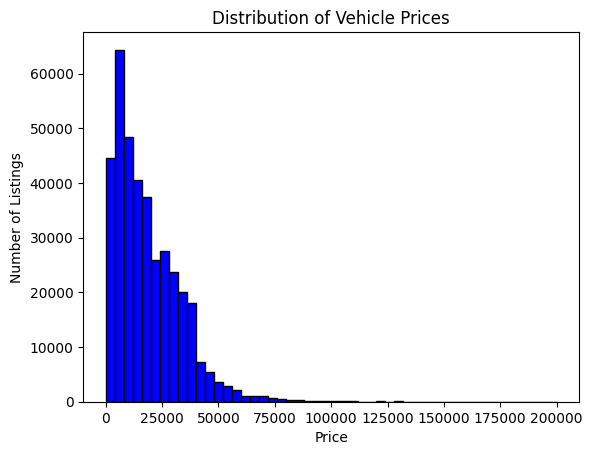

In [ ]:
# Next let's look at price, since that's what we're trying to predict.

import matplotlib.pyplot as plt

price_series = df["price"]

# Count of missing price values
missing_price = price_series.isna().sum()
print(f"Missing price values: {missing_price}")

highest_prices = price_series.sort_values(ascending=False).head(5)
print(f"Highest prices: {highest_prices}")

lowest_prices = price_series.sort_values(ascending=True).head(5)
print(f"Lowest prices: {lowest_prices}")

zero_count = (price_series == 0).sum()
print(f"Zero price count: {zero_count}")


filtered_prices = price_series[(price_series > 0) & (price_series < 200_000)]

plt.hist(filtered_prices, bins=50, color='blue', edgecolor='black')
plt.xlabel('Price')
plt.ylabel('Number of Listings')
plt.title('Distribution of Vehicle Prices')
plt.show()



Although the price data has no null rows, there are 31434 listings that have a price of 0. There are also listings that have prices of 3.7 billion dollars, so we definitely need to do some cleaning.

In [7]:
# Print percent missing for each column in the DataFrame
percent_missing = df.isnull().mean() * 100
for col, pct in percent_missing.items():
    print(f"{col}: {pct:.2f}% missing")


id: 0.00% missing
url: 0.00% missing
region: 0.00% missing
region_url: 0.00% missing
price: 0.00% missing
year: 0.00% missing
manufacturer: 0.00% missing
model: 1.27% missing
condition: 40.88% missing
cylinders: 41.43% missing
fuel: 0.62% missing
odometer: 1.01% missing
title_status: 1.89% missing
transmission: 0.56% missing
VIN: 36.93% missing
drive: 30.10% missing
size: 71.83% missing
type: 21.11% missing
paint_color: 30.34% missing
image_url: 0.00% missing
description: 0.00% missing
county: 100.00% missing
state: 0.00% missing
lat: 1.53% missing
long: 1.53% missing
posting_date: 0.00% missing


In [19]:
if "posting_date" in df.columns:
    dates = pd.to_datetime(df["posting_date"], errors="coerce")
    min_date = dates.min()
    max_date = dates.max()
    print(f"Listing posting date range: {min_date} to {max_date}")

else:
    print("No posting_date column found.")

if "state" in df.columns:
    unique_states = sorted(df["state"].dropna().unique())
    print(f"States in dataset ({len(unique_states)}): {', '.join(unique_states)}")



Listing posting date range: 2021-04-04 03:00:25-04:00 to 2021-05-04 23:24:09-05:00
States in dataset (51): ak, al, ar, az, ca, co, ct, dc, de, fl, ga, hi, ia, id, il, in, ks, ky, la, ma, md, me, mi, mn, mo, ms, mt, nc, nd, ne, nh, nj, nm, nv, ny, oh, ok, or, pa, ri, sc, sd, tn, tx, ut, va, vt, wa, wi, wv, wy


/var/folders/dp/18mgh39122bghz9h0h7dnv940000gn/T/ipykernel_15546/130137415.py:2: FutureWarning: In a future version of pandas, parsing datetimes with mixed time zones will raise an error unless `utc=True`. Please specify `utc=True` to opt in to the new behaviour and silence this warning. To create a `Series` with mixed offsets and `object` dtype, please use `apply` and `datetime.datetime.strptime`
  dates = pd.to_datetime(df["posting_date"], errors="coerce")


In [ ]:

# Manufacturer volume & medians
manu_stats = df.groupby("manufacturer")["price"].agg(["count", "median"]).sort_values("count", ascending=False)
print("Top 5 manufacturers by number of listings and their median price:")
print(manu_stats.head(5))

# Vehicle type volume & medians
if "type" in df.columns:
    type_stats = df.groupby("type")["price"].agg(["count", "median"]).sort_values("count", ascending=False)
    print("\nTop 5 vehicle types by number of listings and their median price:")
    print(type_stats.head(5))
else:
    print("\n'type' column not found in dataframe.")

# State-level median prices
if "state" in df.columns:
    state_stats = df.groupby("state")["price"].median().sort_values(ascending=False)
    print("\nTop 5 states by median listing price:")
    print(state_stats.head(5))
    print("\nBottom 5 states by median listing price:")
    print(state_stats.tail(5))
else:
    print("\n'state' column not found in dataframe.")


Top 5 manufacturers by number of listings and their median price:
              count   median
manufacturer                
ford          36349  12997.0
chevrolet     28423  11995.0
toyota        19195   9999.0
honda         13441   7999.0
nissan        10961   8995.0

Top 5 vehicle types by number of listings and their median price:
        count   median
type                  
sedan   45577   8988.0
SUV     42711  12977.0
truck   16903  19900.0
pickup  16066  21990.0
coupe    8527  12999.0

Top 5 states by median listing price:
state
ak    21995.0
hi    17999.0
al    17240.0
id    15996.0
wa    15910.5
Name: price, dtype: float64

Bottom 5 states by median listing price:
state
oh    8204.5
va    8000.0
pa    7900.0
ri    7490.0
de    7300.0
Name: price, dtype: float64


In [8]:
# For each manufacturer, print the most expensive listing under 1 million dollars
def print_most_expensive_listings(df):
    max_price = 1_000_000
    manufacturers = df["manufacturer"].dropna().unique()

    for manu in sorted(manufacturers):
        manu_df = df[(df["manufacturer"] == manu) & (df["price"] < max_price)]
        if manu_df.empty:
            print(f"{manu}: No listings under ${max_price:,}")
            continue
        max_row = manu_df.loc[manu_df["price"].idxmax()]
        print(f"{manu}:")
        print(f"  Price: ${max_row['price']:,}")
        print(f"  Model: {max_row.get('model', 'N/A')}")
        print()

print_most_expensive_listings(df)


acura:
  Price: $139,999
  Model: nsx

alfa-romeo:
  Price: $62,950
  Model: romeo gtv 2000

aston-martin:
  Price: $179,888
  Model: martin db11

audi:
  Price: $160,000
  Model: r8 v10 plus

bmw:
  Price: $138,000
  Model: m models competition

buick:
  Price: $123,456
  Model: lacrosse

cadillac:
  Price: $195,000
  Model: srx awd luxury

chevrolet:
  Price: $152,995
  Model: corvette

chrysler:
  Price: $655,000
  Model: town & country

datsun:
  Price: $30,000
  Model: 240z

dodge:
  Price: $180,000
  Model: charger

ferrari:
  Price: $449,500
  Model: 488 gtb

fiat:
  Price: $32,500
  Model: 124 spider abarth

ford:
  Price: $999,999
  Model: f-350

gmc:
  Price: $777,777
  Model: sierra

harley-davidson:
  Price: $39,900
  Model: davidson

honda:
  Price: $123,456
  Model: accord sport se

hyundai:
  Price: $50,000
  Model: elantra gls

infiniti:
  Price: $69,995
  Model: qx80

jaguar:
  Price: $150,000
  Model: xk 150

jeep:
  Price: $425,000
  Model: wrangler

kia:
  Price: $5

## Data Cleaning
There are no cars that are truly over $1 million in this dataset. We can discard all prices over $1 million
Also, it would be good to discard outliers based on each manufacturer. For example, there is no reason that a buick lacrosse is $123,456. That is obviously a made-up number and should be excluded as an outlier.

In [9]:

# Create a mapping of brands to their categories
economy_brands = [
    "buick", "chevrolet", "chrysler", "dodge", "fiat", "ford",
    "gmc", "honda", "hyundai", "jeep", "kia", "mazda",
    "mitsubishi", "ram", "saturn", "subaru",
    "toyota"
]

luxury_brands = [
    "acura", "alfa-romeo", "bmw", "cadillac", "infiniti",
    "jaguar", "land rover", "lexus", "lincoln", "mercury",
    "mini", "nissan", "volkswagen", "volvo"
]

exotic_brands = [
    "aston-martin", "audi", "datsun", "ferrari", "morgan",
    "mercedes-benz", "pontiac", "porsche", "rover", "tesla"
]


In [10]:
import numpy as np
df["brand_category"] = df["manufacturer"].apply(lambda x: "economy" if x in economy_brands else "luxury" if x in luxury_brands else "exotic")

df["age"] = 2022 - df["year"]
df["age"] = df["age"].clip(lower=1)

df = df[df["price"] < 1000000]
df = df[df["price"] > 100]

#df['price_mileage_ratio'] = df['price'] / (df['odometer'] / df['age'])

df['use_mileage'] = np.where(df['year'] >= 2005, df['odometer'], np.nan)
df['price_mileage_ratio'] = df['price'] / (df['use_mileage'] / df['age'])

df["year_band"] = (df["year"] // 5) * 5


df = df[df["odometer"] > 20]

df = df[~df.duplicated(subset=["manufacturer", "model", "year", "price", "odometer"], keep='first')]



In [11]:
def simplify_model(m):
    m = str(m).lower()
    m = m.split()[0] if m else "unknown"
    return m

df["model_simple"] = df["model"].apply(simplify_model)

# --- Compute robust stats (median & MAD) ---
grouped = df.groupby(["manufacturer", "model_simple", "year_band"])

stats = grouped["price"].agg(
    median_price="median",
    mad=lambda x: np.median(np.abs(x - np.median(x)))
).reset_index()

# Prevent division-by-zero by clamping MAD to at least 1
stats["mad"] = stats["mad"].apply(lambda x: max(x, 1.0))

print(stats.head(10))

# --- Merge stats back ---
df = df.merge(stats, on=["manufacturer", "model_simple", "year_band"], how="left")

  manufacturer model_simple  year_band  median_price     mad
0        acura         2002     2000.0        7900.0     1.0
1        acura        3.0cl     1995.0        1000.0   200.0
2        acura          3.2     2000.0        4500.0  1500.0
3        acura          3.2     2005.0        4850.0  1000.0
4        acura        3.2tl     1995.0        4500.0     1.0
5        acura        3.2tl     2000.0        3995.0     1.0
6        acura        3.2tl     2005.0        6949.5   950.5
7        acura          3.5     2000.0        3700.0   700.0
8        acura        3.5rl     2000.0        3500.0     1.0
9        acura           cl     1995.0        3200.0   700.0


In [12]:
suspect_price_strings = {"123456", "234567", "345678", "456789", "56789", "654321", "765432", "876543", "987654", "111111", "222222", "333333", "444444", "555555", "666666", "777777", "888888", "999999"}

def score_row(row):
    score = 0
    signals = []

    # Robust z-score based on median and MAD
    if pd.notnull(row["median_price"]):
        robust_z = abs(row["price"] - row["median_price"]) / row["mad"]
        if robust_z >= 20:
            score += 5
        elif robust_z >= 8:
            score += 3
            signals.append(f"robust_z={robust_z:.1f}")
        elif robust_z >= 5:
            score += 2
            signals.append(f"robust_z={robust_z:.1f}")

    # Tier-based sanity check
    if row["brand_category"] == "economy" and row["price"] > 90_000:
        score += 2
        signals.append("high_economy_price")
    elif row["brand_category"] == "luxury" and row["price"] > 300_000:
        score += 1.5
        signals.append("high_luxury_price")

    # Suspicious price patterns
    if str(int(row["price"])) in suspect_price_strings:
        score += 5
        signals.append("price_pattern")

    # Odometer sanity checks
    miles_per_year = row["odometer"] / row["age"]
    if row["year"] >= 1980 and miles_per_year > 60_000:
        score += 2
        signals.append(f"miles_per_year={miles_per_year:.0f}")
    if row["year"] >= 1980 and row["age"] >= 5 and miles_per_year < 250 and row["price"] < 150_000:
        score += 1
        signals.append(f"low_usage={miles_per_year:.0f}")
    if row["year"] >= 1990 and row["odometer"] >= 150_000 and row["price"] > 65_000 and row["brand_category"] != "exotic":
        score += 1.5
        signals.append("price_vs_miles")

    return pd.Series({"score": score, "signals": ", ".join(signals)})

# --- Apply scoring ---
df[["score", "signals"]] = df.apply(score_row, axis=1)


In [ ]:
# Print vehicles with the highest score 
import tabulate

cols = ["score", "year", "price", "odometer", "manufacturer", "model", "signals"]
# Sort all rows by score descending and take the top 100 by suspiciousness
top_rows = df[df["year"] > 1980][cols].sort_values(by="score", ascending=False).head(100)
print(tabulate.tabulate(top_rows, headers="keys", tablefmt="github", showindex=False))

|   score |   year |   price |       odometer | manufacturer   | model                      | signals                                           |
|---------|--------|---------|----------------|----------------|----------------------------|---------------------------------------------------|
|    13.5 |   2008 |  123456 | 185000         | ford           | explorer xlt 4x4           | high_economy_price, price_pattern, price_vs_miles |
|    13.5 |   2006 |  111111 | 200000         | dodge          | caravan                    | high_economy_price, price_pattern, price_vs_miles |
|    13.5 |   2003 |  123456 | 165000         | chevrolet      | tahoe                      | high_economy_price, price_pattern, price_vs_miles |
|    13.5 |   2006 |  999999 | 204123         | ford           | f-350                      | high_economy_price, price_pattern, price_vs_miles |
|    13.5 |   1997 |  123456 | 270000         | chevrolet      | tahoe                      | high_economy_price, price_patt

In [ ]:
df_cleaned = df[df["score"] <= 4]

In [ ]:
print_most_expensive_listings(df_cleaned)

acura:
  Price: $139,999
  Model: nsx

alfa-romeo:
  Price: $62,950
  Model: romeo gtv 2000

aston-martin:
  Price: $179,888
  Model: martin db11

audi:
  Price: $160,000
  Model: r8 v10 plus

bmw:
  Price: $138,000
  Model: m models competition

buick:
  Price: $110,000
  Model: skylark convertible

cadillac:
  Price: $126,995
  Model: escalade

chevrolet:
  Price: $150,000
  Model: nan

chrysler:
  Price: $86,000
  Model: valiant charger

datsun:
  Price: $30,000
  Model: 240z

dodge:
  Price: $109,000
  Model: srt viper

ferrari:
  Price: $449,500
  Model: 488 gtb

fiat:
  Price: $32,500
  Model: 124 spider abarth

ford:
  Price: $119,995
  Model: super duty f-450 pickup

gmc:
  Price: $90,000
  Model: sierra 2500hd denali

harley-davidson:
  Price: $39,900
  Model: davidson

honda:
  Price: $69,891
  Model: hr-v

hyundai:
  Price: $49,788
  Model: palisade limited

infiniti:
  Price: $69,995
  Model: qx80

jaguar:
  Price: $150,000
  Model: xk 150

jeep:
  Price: $89,999
  Model: g

## Graphics

Listing count by brand category:
  Economy: 157,876
  Luxury: 41,573
  Exotic: 13,376


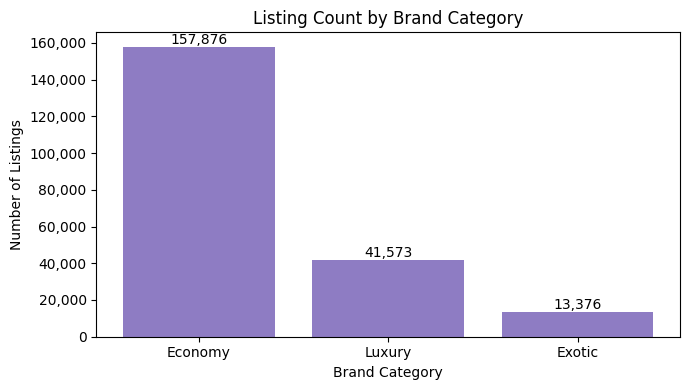

In [ ]:
# Print the count of listings in each brand category
brand_counts = clean_df['brand_category'].value_counts()
print("Listing count by brand category:")
for category, count in brand_counts.items():
    print(f"  {category.title()}: {count:,}")

# Plot a bar chart of listing count by brand category
fig, ax = plt.subplots(figsize=(7, 4))
ax.bar(brand_counts.index.str.title(), brand_counts.values, color="#8e7cc3")
ax.set_title("Listing Count by Brand Category")
ax.set_xlabel("Brand Category")
ax.set_ylabel("Number of Listings")
ax.yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}'))
for i, v in enumerate(brand_counts.values):
    ax.text(i, v, f"{v:,}", ha='center', va='bottom', fontsize=10)
plt.tight_layout()
plt.show()



  0–10th percentile ($101–$3,200): 20,698 listings
  10–20th percentile ($3,200–$5,000): 21,724 listings
  20–30th percentile ($5,000–$6,950): 21,031 listings
  30–40th percentile ($6,950–$8,950): 21,438 listings
  40–50th percentile ($8,950–$11,475): 21,510 listings
  50–60th percentile ($11,475–$14,681): 21,284 listings
  60–70th percentile ($14,681–$18,217): 21,280 listings
  70–80th percentile ($18,217–$23,995): 20,850 listings
  80–90th percentile ($23,995–$32,998): 21,689 listings
  90–100th percentile ($32,998–$199,999): 21,305 listings


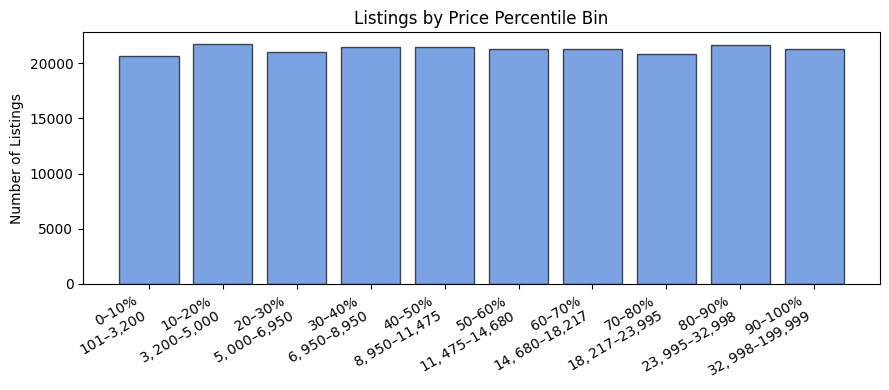

In [ ]:
# Calculate price percentiles and bin listing counts per bin

import numpy as np
import matplotlib.pyplot as plt

# Choose percentiles (e.g., 0–10, 10–20, ..., 90–100)
percentiles = np.arange(0, 101, 10)

# Filter out zero and extreme prices for percentiles, as done with filtered_prices
clean_prices = clean_df['price'][(clean_df['price'] > 0) & (clean_df['price'] < 200_000)]

# Get bin edges for percentiles
bin_edges = np.percentile(clean_prices, percentiles)

# Assign each price to a percentile bin
# -1 so each bin is [edge_i, edge_{i+1}), except last, which includes right edge
labels = []
counts = []
for i in range(len(bin_edges)-1):
    if i == len(bin_edges)-2:
        # Include the top edge in the last bin
        bin_mask = (clean_prices >= bin_edges[i]) & (clean_prices <= bin_edges[i+1])
    else:
        bin_mask = (clean_prices >= bin_edges[i]) & (clean_prices < bin_edges[i+1])
    count = bin_mask.sum()
    labels.append(f"{int(percentiles[i])}–{int(percentiles[i+1])}%\n${int(bin_edges[i]):,}–${int(bin_edges[i+1]):,}")
    counts.append(count)
    print(f"  {percentiles[i]:.0f}–{percentiles[i+1]:.0f}th percentile (${bin_edges[i]:,.0f}–${bin_edges[i+1]:,.0f}): {count:,} listings")

# Plot bar graph for bins
plt.figure(figsize=(9, 4))
bars = plt.bar(labels, counts, color="#3c78d8", alpha=0.68, edgecolor='black')
plt.ylabel("Number of Listings")
plt.title("Listings by Price Percentile Bin")
plt.xticks(rotation=30, ha='right')
plt.tight_layout()
plt.show()



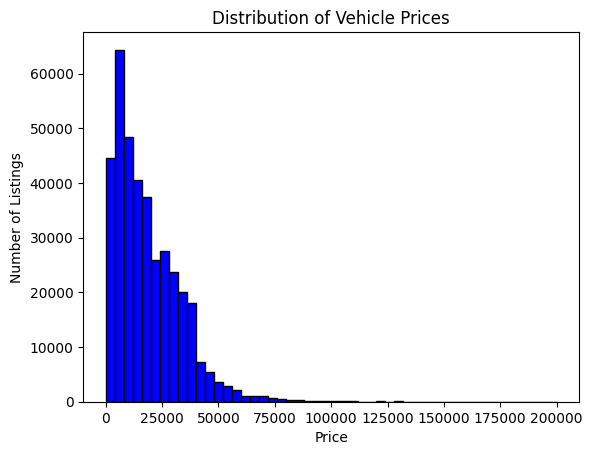

In [ ]:
filtered_prices = price_series[(price_series > 0) & (price_series < 200_000)]

plt.hist(filtered_prices, bins=50, color='blue', edgecolor='black')
plt.xlabel('Price')
plt.ylabel('Number of Listings')
plt.title('Distribution of Vehicle Prices')
plt.show()
